In [30]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.decomposition import PCA
from ydata_profiling import ProfileReport

In [54]:
df = pd.read_csv('../data/raw/train.csv')
df.head(5)

,id,Marital status,Application mode,Application order,Course,Daytime/evening attendance,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,0,1,1,1,9238,1,1,126.0,1,1,...,0,6,7,6,12.428571,0,11.1,0.6,2.02,Graduate
1,1,1,17,1,9238,1,1,125.0,1,19,...,0,6,9,0,0.000000,0,11.1,0.6,2.02,Dropout
2,2,1,17,2,9254,1,1,137.0,1,3,...,0,6,0,0,0.000000,0,16.2,0.3,-0.92,Dropout
3,3,1,1,3,9500,1,1,131.0,1,19,...,0,8,11,7,12.820000,0,11.1,0.6,2.02,Enrolled
4,4,1,1,2,9500,1,1,132.0,1,19,...,0,7,12,6,12.933333,0,7.6,2.6,0.32,Graduate


In [55]:
con = ['Previous qualification (grade)', 
       'Admission grade', 
       'Age at enrollment', 
       'Curricular units 1st sem (credited)',
       'Curricular units 1st sem (enrolled)',
       'Curricular units 1st sem (evaluations)',
       'Curricular units 1st sem (approved)',
       'Curricular units 1st sem (grade)',
       'Curricular units 1st sem (without evaluations)',
       'Curricular units 2nd sem (credited)',
       'Curricular units 2nd sem (enrolled)',
       'Curricular units 2nd sem (evaluations)',
       'Curricular units 2nd sem (approved)',
       'Curricular units 2nd sem (grade)',
       'Curricular units 2nd sem (without evaluations)',
       'Unemployment rate',
       'Inflation rate',
       'GDP']

df.loc[:, con]

,Previous qualification (grade),Admission grade,Age at enrollment,Curricular units 1st sem (credited),Curricular units 1st sem (enrolled),Curricular units 1st sem (evaluations),Curricular units 1st sem (approved),Curricular units 1st sem (grade),Curricular units 1st sem (without evaluations),Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP
0,126.0,122.6,18,0,6,6,6,14.500000,0,0,6,7,6,12.428571,0,11.1,0.6,2.02
1,125.0,119.8,18,0,6,8,4,11.600000,0,0,6,9,0,0.000000,0,11.1,0.6,2.02
2,137.0,144.7,18,0,6,0,0,0.000000,0,0,6,0,0,0.000000,0,16.2,0.3,-0.92
3,131.0,126.1,18,0,7,9,7,12.591250,0,0,8,11,7,12.820000,0,11.1,0.6,2.02
4,132.0,120.1,18,0,7,12,6,12.933333,0,0,7,12,6,12.933333,0,7.6,2.6,0.32
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76513,121.0,116.5,18,0,6,9,6,10.666667,0,0,6,8,5,10.600000,0,13.9,-0.3,0.79
76514,125.0,131.6,19,0,6,22,4,13.000000,0,0,6,9,6,13.875000,0,9.4,-0.8,-3.12
76515,138.0,123.3,19,0,5,13,4,12.500000,2,0,5,8,5,11.400000,1,9.4,-0.8,-3.12
76516,136.0,124.8,18,0,6,0,0,0.000000,0,0,6,0,0,0.000000,0,7.6,2.6,0.32


In [5]:
# Criar o relatório
profile = ProfileReport(df.loc[:, con], title='Relatório de Análise Exploratória', explorative=True)

# Exibir o relatório no Jupyter Notebook (opcional)
profile.to_notebook_iframe()

profile.to_file('../reports/EDA.html')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

# To do list

- Analisar variáveis quantitativas
- Criar relatórios de análises
- Tomar decisões (eliminar variáveis, unir, criar novas, etc)
- Analisar variáveis qualitativas
- Criar relatórios de análises
- Tomar decisões (eliminar variáveis, unir, criar novas, etc)
- Manter a etapa de correlação do outro notebook
- Integrar as análises deste notebook ao outro
- Explorar individualmente uma variável ou relações de variáveis (análise univariada e bivariada)
- Organizar Storytelling com base em insights

In [56]:
df[['id', 'Admission grade', 'Previous qualification (grade)']]

,id,Admission grade,Previous qualification (grade)
0,0,122.6,126.0
1,1,119.8,125.0
2,2,144.7,137.0
3,3,126.1,131.0
4,4,120.1,132.0
...,...,...,...
76513,76513,116.5,121.0
76514,76514,131.6,125.0
76515,76515,123.3,138.0
76516,76516,124.8,136.0


In [57]:
slice = df[['Curricular units 1st sem (approved)', 'Curricular units 1st sem (enrolled)', 
            'Curricular units 1st sem (grade)', 'Curricular units 2nd sem (approved)', 
            'Curricular units 2nd sem (enrolled)', 'Curricular units 2nd sem (grade)']]

slice.head(5)

,Curricular units 1st sem (approved),Curricular units 1st sem (enrolled),Curricular units 1st sem (grade),Curricular units 2nd sem (approved),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (grade)
0,6,6,14.500000,6,6,12.428571
1,4,6,11.600000,0,6,0.000000
2,0,6,0.000000,0,6,0.000000
3,7,7,12.591250,7,8,12.820000
4,6,7,12.933333,6,7,12.933333


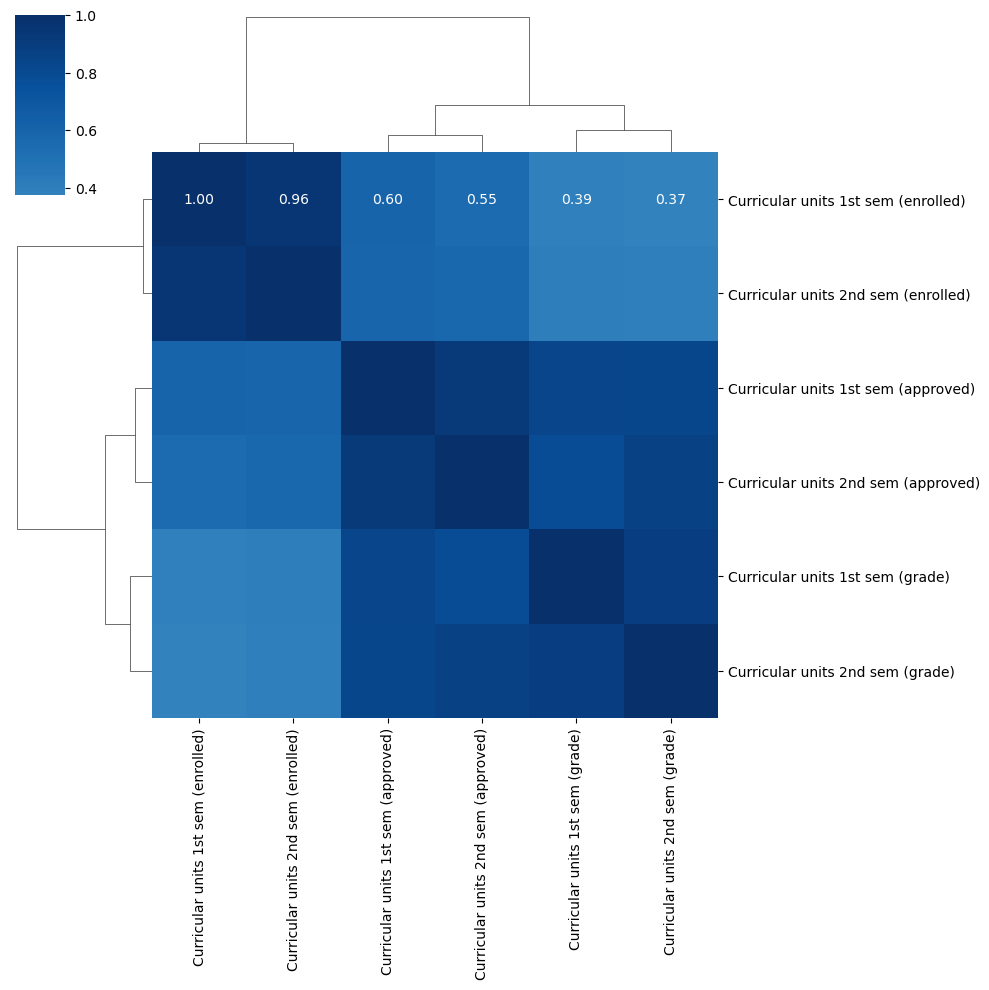

In [58]:
%matplotlib inline

corr = slice.corr()

sns.clustermap(corr, cmap='Blues', center=0, annot=True, fmt='.2f')

plt.show()

In [59]:
slice.corr().mean()

Curricular units 1st sem (approved)    0.797104
Curricular units 1st sem (enrolled)    0.644494
Curricular units 1st sem (grade)       0.717671
Curricular units 2nd sem (approved)    0.781696
Curricular units 2nd sem (enrolled)    0.652107
Curricular units 2nd sem (grade)       0.724446
dtype: float64

In [60]:
slice = slice.copy()
slice['comp'] = pca.fit_transform(slice)

pca.explained_variance_ratio_

array([0.8609768])

In [61]:
slice['comp'] = pca.fit_transform(slice)

slice.corr()[]

,Curricular units 1st sem (approved),Curricular units 1st sem (enrolled),Curricular units 1st sem (grade),Curricular units 2nd sem (approved),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (grade),comp
Curricular units 1st sem (approved),1.000000,0.599526,0.839860,0.922657,0.590151,0.830430,0.907488
Curricular units 1st sem (enrolled),0.599526,1.000000,0.388141,0.548000,0.956321,0.374975,0.467969
Curricular units 1st sem (grade),0.839860,0.388141,1.000000,0.787559,0.401075,0.889393,0.959291
Curricular units 2nd sem (approved),0.922657,0.548000,0.787559,1.000000,0.572588,0.859370,0.898812
Curricular units 2nd sem (enrolled),0.590151,0.956321,0.401075,0.572588,1.000000,0.392509,0.482327
Curricular units 2nd sem (grade),0.830430,0.374975,0.889393,0.859370,0.392509,1.000000,0.970607
comp,0.907488,0.467969,0.959291,0.898812,0.482327,0.970607,1.000000


In [63]:
slice.corr()['comp'].mean()

0.8123562820533274

In [65]:
df_2 = df.drop([col for col in slice.drop('comp', axis=1).columns], axis=1).copy().assign(academic_performance = slice['comp'])
df_2.head(5)

,id,Marital status,Application mode,Application order,Course,Daytime/evening attendance,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,...,Curricular units 1st sem (evaluations),Curricular units 1st sem (without evaluations),Curricular units 2nd sem (credited),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target,academic_performance
0,0,1,1,1,9238,1,1,126.0,1,1,...,6,0,0,7,0,11.1,0.6,2.02,Graduate,8.133190
1,1,1,17,1,9238,1,1,125.0,1,19,...,8,0,0,9,0,11.1,0.6,2.02,Dropout,-9.270283
2,2,1,17,2,9254,1,1,137.0,1,3,...,0,0,0,0,0,16.2,0.3,-0.92,Dropout,-21.001193
3,3,1,1,3,9500,1,1,131.0,1,19,...,9,0,0,11,0,11.1,0.6,2.02,Enrolled,8.090571
4,4,1,1,2,9500,1,1,132.0,1,19,...,12,0,0,12,0,7.6,2.6,0.32,Graduate,7.510525


In [66]:
df_2.columns

Index(['id', 'Marital status', 'Application mode', 'Application order',
       'Course', 'Daytime/evening attendance', 'Previous qualification',
       'Previous qualification (grade)', 'Nacionality',
       'Mother's qualification', 'Father's qualification',
       'Mother's occupation', 'Father's occupation', 'Admission grade',
       'Displaced', 'Educational special needs', 'Debtor',
       'Tuition fees up to date', 'Gender', 'Scholarship holder',
       'Age at enrollment', 'International',
       'Curricular units 1st sem (credited)',
       'Curricular units 1st sem (evaluations)',
       'Curricular units 1st sem (without evaluations)',
       'Curricular units 2nd sem (credited)',
       'Curricular units 2nd sem (evaluations)',
       'Curricular units 2nd sem (without evaluations)', 'Unemployment rate',
       'Inflation rate', 'GDP', 'Target', 'academic_performance'],
      dtype='object')

In [68]:
slice_2 = df[['Curricular units 1st sem (credited)',
              'Curricular units 1st sem (evaluations)',
              'Curricular units 1st sem (without evaluations)',
              'Curricular units 2nd sem (credited)',
              'Curricular units 2nd sem (evaluations)',
              'Curricular units 2nd sem (without evaluations)']]

slice_3 = pd.concat([slice,slice_2], axis=1)
slice_3

,Curricular units 1st sem (approved),Curricular units 1st sem (enrolled),Curricular units 1st sem (grade),Curricular units 2nd sem (approved),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (grade),comp,Curricular units 1st sem (credited),Curricular units 1st sem (evaluations),Curricular units 1st sem (without evaluations),Curricular units 2nd sem (credited),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (without evaluations)
0,6,6,14.500000,6,6,12.428571,8.133190,0,6,0,0,7,0
1,4,6,11.600000,0,6,0.000000,-9.270283,0,8,0,0,9,0
2,0,6,0.000000,0,6,0.000000,-21.001193,0,0,0,0,0,0
3,7,7,12.591250,7,8,12.820000,8.090571,0,9,0,0,11,0
4,6,7,12.933333,6,7,12.933333,7.510525,0,12,0,0,12,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
76513,6,6,10.666667,5,6,10.600000,2.692526,0,9,0,0,8,0
76514,4,6,13.000000,6,6,13.875000,7.331970,0,22,0,0,9,0
76515,4,5,12.500000,5,5,11.400000,3.914568,0,13,2,0,8,1
76516,0,6,0.000000,0,6,0.000000,-21.001193,0,0,0,0,0,0


In [78]:
(df['Target'].value_counts() / len(df['Target'])) * 100

Target
Graduate    47.416294
Dropout     33.058888
Enrolled    19.524818
Name: count, dtype: float64

In [90]:
slice_3['target'] = df['Target'].copy().map({'Graduate': 0, 'Dropout': 1, 'Enrolled': 2})
slice_3.corr()['target'].iloc[:5].mean()

-0.30767370775294395

In [91]:
slice_3.corr()['target'].iloc[6]

-0.32853568093951

In [88]:
slice_3.corr()['target']

Curricular units 1st sem (approved)              -0.406249
Curricular units 1st sem (enrolled)              -0.188270
Curricular units 1st sem (grade)                 -0.272594
Curricular units 2nd sem (approved)              -0.458061
Curricular units 2nd sem (enrolled)              -0.213194
Curricular units 2nd sem (grade)                 -0.291505
comp                                             -0.328536
Curricular units 1st sem (credited)              -0.033397
Curricular units 1st sem (evaluations)            0.095589
Curricular units 1st sem (without evaluations)    0.053365
Curricular units 2nd sem (credited)              -0.036499
Curricular units 2nd sem (evaluations)            0.084115
Curricular units 2nd sem (without evaluations)    0.068818
target                                            1.000000
Name: target, dtype: float64

In [94]:
slice_3.corr()['target'].iloc[7:].mean()

0.17599864099589116

In [103]:
(df['Curricular units 1st sem (approved)'].value_counts() / df.shape[0]) * 100

Curricular units 1st sem (approved)
6     28.823283
0     20.953240
5     16.007998
7      9.882642
4      9.167778
3      6.139732
2      3.234533
1      2.543192
8      1.790428
11     0.362006
12     0.291435
9      0.250921
10     0.169895
13     0.152905
14     0.058810
18     0.054889
17     0.044434
15     0.026138
19     0.013069
16     0.013069
21     0.011762
20     0.003921
26     0.003921
Name: count, dtype: float64

In [104]:
(df['Curricular units 2nd sem (approved)'].value_counts() / df.shape[0]) * 100

Curricular units 2nd sem (approved)
6     24.956219
0     24.148566
5     15.460415
4      8.761337
8      6.669019
3      6.565775
7      6.026033
2      4.055255
1      2.175959
11     0.363313
9      0.232625
10     0.228704
12     0.171202
13     0.105857
17     0.023524
14     0.022217
18     0.011762
16     0.009148
19     0.007841
15     0.002614
20     0.002614
Name: count, dtype: float64